In [46]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append("dependencies")
from helpers import *
from music21 import *
from music21.repeat import Expander
from gensim.models import FastText
import numpy as np
import pickle
import matplotlib.pyplot as plt
import librosa
import pandas as pd
import librosa
import librosa.display
from sklearn.metrics.pairwise import cosine_similarity
from IPython.display import Audio
from music21 import stream
import os
import music21


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Getting the score and dividing in left / right hand

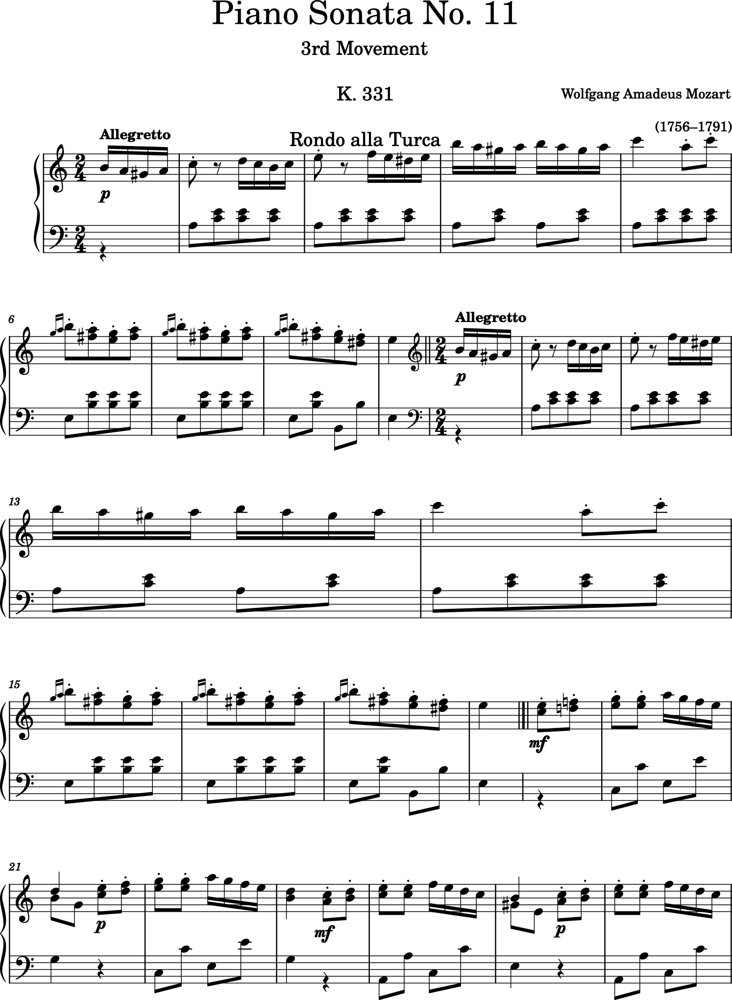

In [47]:
# Import, linearize, and display the sample piece
sample_score = converter.parse('xml/xml_score.musicxml') # converter is from the music21 package
linearized_sample_score = sample_score.expandRepeats() # "Unfolds" repeat measures. Important for visualizing repetitions!
linearized_sample_score.show()

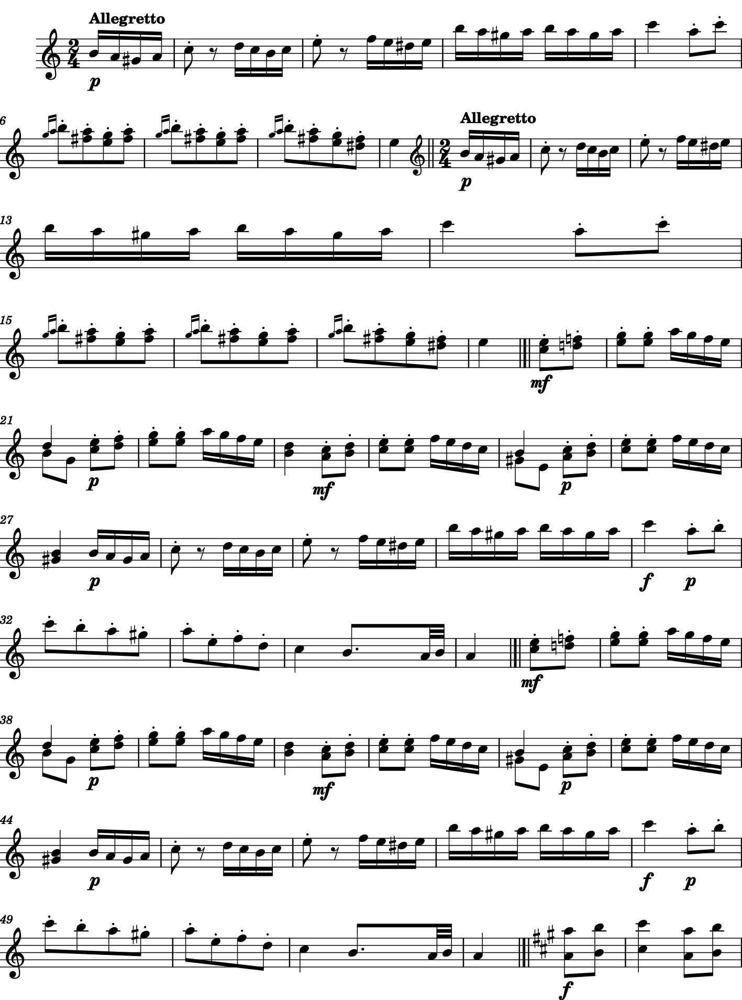

In [48]:
right_hand = sample_score.parts[0]  # Assuming the right hand is the first part
right_hand_notes = [note for note in right_hand.recurse().notes]


linearized_right_score = right_hand.expandRepeats() # "Unfolds" repeat measures. Important for visualizing repetitions!
linearized_right_score.show()

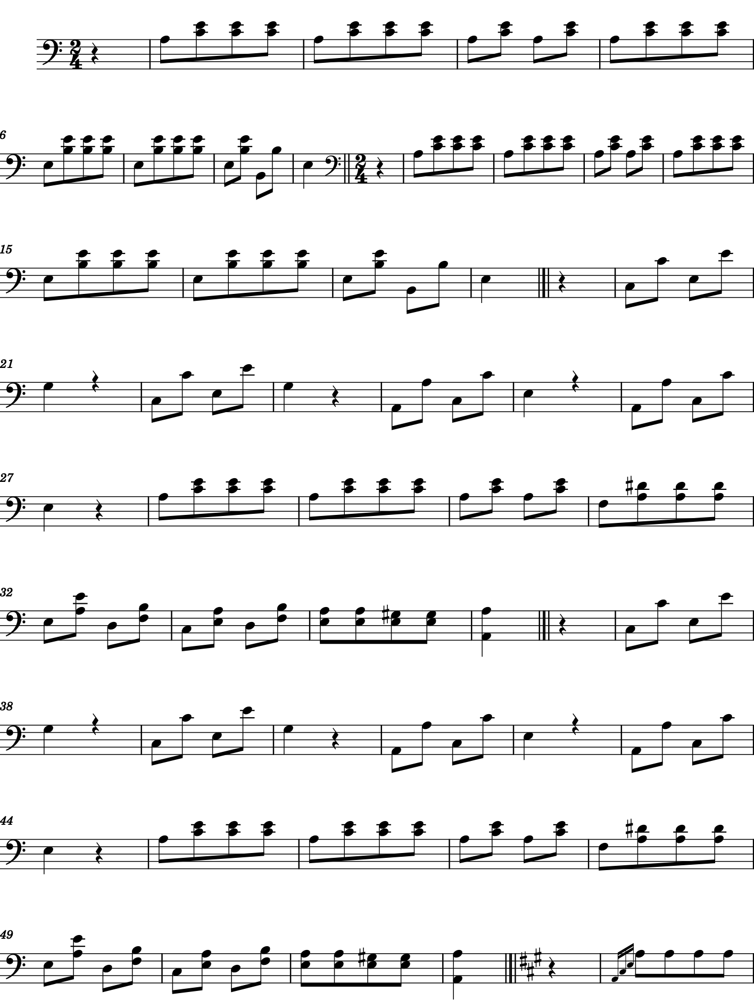

In [49]:
left_hand = sample_score.parts[1]  # Assuming the right hand is the first part
left_hand_notes = [note for note in right_hand.recurse().notes]

#not really using repetitions in the end
linearized_left_score = left_hand.expandRepeats() # "Unfolds" repeat measures. Important for visualizing repetitions!
linearized_left_score.show()

# Self-Similarity Matrices
We play around experiment with the self-similarity matrices, before choosing the right fit for our model.

## SSM for individual notes

In [50]:
left_hand_midi_sequence = []
right_hand_midi_sequence = []

for event in left_hand.recurse().notes:
    if event.isNote:
        left_hand_midi_sequence.append(event.pitch.midi)
    elif event.isChord:
        for note in event:
            left_hand_midi_sequence.append(note.pitch.midi)


for event in right_hand.recurse().notes:
    if event.isNote:
        right_hand_midi_sequence.append(event.pitch.midi)
    elif event.isChord:
        for note in event:
            right_hand_midi_sequence.append(note.pitch.midi)


In [51]:
# Kronecker function for upcoming matrix (do not modify)
def kronecker_delta(x, y):
    if x == y:
        return 1
    else:
        return 0

# Create similarity matrix from MIDI note numbers
def calculate_ssm(sequence):
    length = len(sequence)
    ssm = np.zeros((length, length))

    ## STUDENT SECTION - REMOVE ALL OR SOME OF CODE ##
    i = 0
    for element_i in sequence:
        j = 0
        for element_j in sequence:
            ssm[i][j] = kronecker_delta(element_i, element_j)
            j += 1
        i += 1
    ## END STUDENT SECTION  ##
    
    return ssm


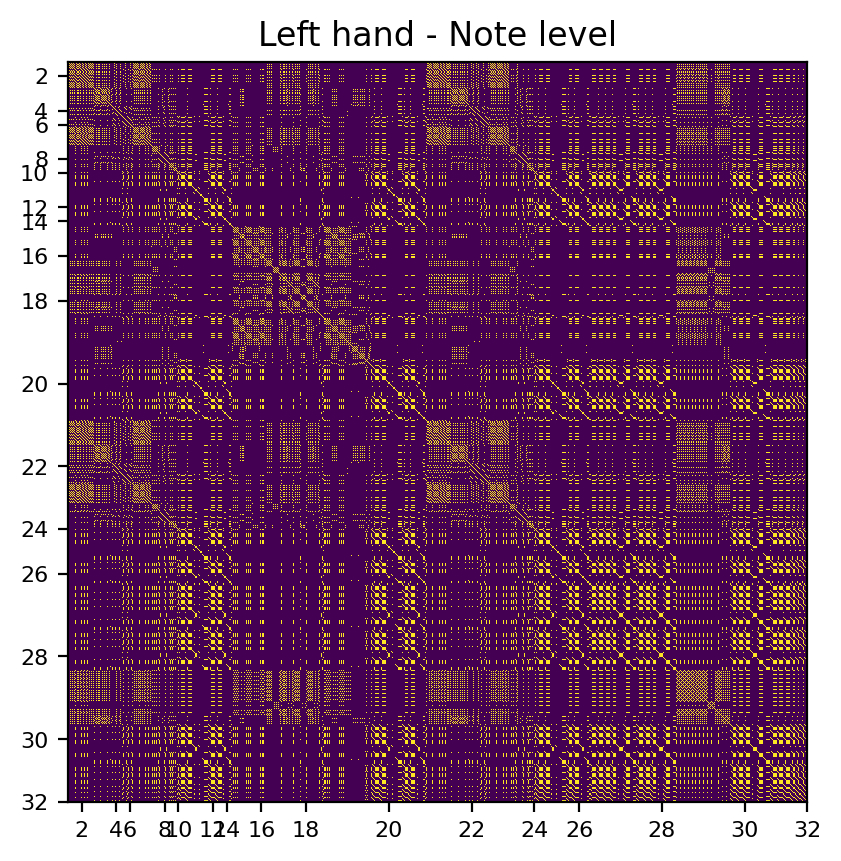

In [52]:
left_self_sim_mat1 = calculate_ssm(left_hand_midi_sequence)

# Display the SSM - there should be a bright diagonal running f rom the top left to the bottom right
plt.imshow(left_self_sim_mat1, cmap='viridis', interpolation='nearest', extent=[0,214,214,0])
plt.xticks([4, 14, 18, 28, 32, 42, 46, 56, 69, 93, 117, 135, 148, 172, 196, 214], ['2', '4', '6', '8', '10', '12', '14', '16', '18', '20', '22', '24', '26', '28', '30', '32'], fontsize=8)
plt.yticks([4, 14, 18, 28, 32, 42, 46, 56, 69, 93, 117, 135, 148, 172, 196, 214], ['2', '4', '6', '8', '10', '12', '14', '16', '18', '20', '22', '24', '26', '28', '30', '32'], fontsize=8)
plt.title("Left hand - Note level")
plt.show()

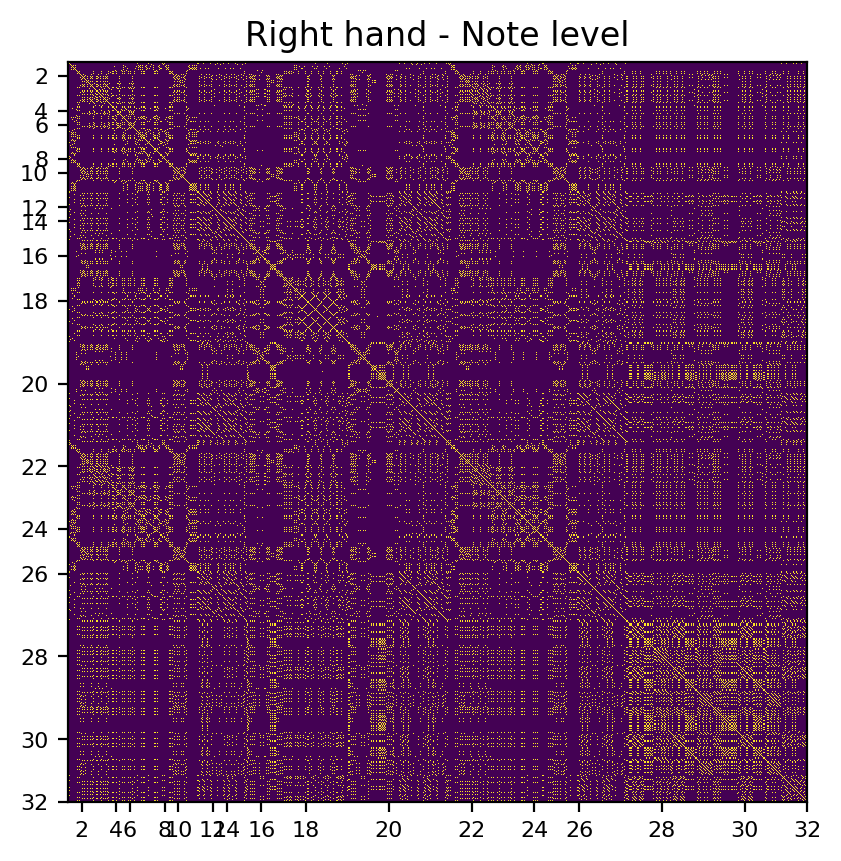

In [53]:
right_self_sim_mat1 = calculate_ssm(right_hand_midi_sequence)

# Display the SSM - there should be a bright diagonal running f rom the top left to the bottom right
plt.imshow(right_self_sim_mat1, cmap='viridis', interpolation='nearest', extent=[0,214,214,0])
plt.xticks([4, 14, 18, 28, 32, 42, 46, 56, 69, 93, 117, 135, 148, 172, 196, 214], ['2', '4', '6', '8', '10', '12', '14', '16', '18', '20', '22', '24', '26', '28', '30', '32'], fontsize=8)
plt.yticks([4, 14, 18, 28, 32, 42, 46, 56, 69, 93, 117, 135, 148, 172, 196, 214], ['2', '4', '6', '8', '10', '12', '14', '16', '18', '20', '22', '24', '26', '28', '30', '32'], fontsize=8)
plt.title("Right hand - Note level")
plt.show()

## SSM for measures

In [54]:
# Cast measures as lists of MIDI note numbers

# Assuming 'left_hand' is a Part object representing the left-hand part of the piano score
left_midi_measure_sequence = []

for measure in left_hand.getElementsByClass(stream.Measure):
    measure_midi_list = []
    for event in measure.recurse().notes:
        if event.isNote:
            measure_midi_list.append(event.pitch.midi)
        elif event.isChord:
            for note in event.notes:
                measure_midi_list.append(note.pitch.midi)
    left_midi_measure_sequence.append(measure_midi_list)


# Assuming 'left_hand' is a Part object representing the left-hand part of the piano score
right_midi_measure_sequence = []

for measure in right_hand.getElementsByClass(stream.Measure):
    measure_midi_list = []
    for event in measure.recurse().notes:
        if event.isNote:
            measure_midi_list.append(event.pitch.midi)
        elif event.isChord:
            for note in event.notes:
                measure_midi_list.append(note.pitch.midi)
    right_midi_measure_sequence.append(measure_midi_list)



In [55]:
# colouring lines when there's the end of a section (check the score tho)
# commenting the horizontal not to create a mess

def drawlines_measures():
    lines = {  
        9: 'red',
        25: 'green',
        34: 'blue',
        43:'orange',
        60:'pink',
        69:'white',
        79:'red',
        95:'green',
        104: 'purple',
        136: 'white'
    }

    for tick, color in lines.items():
        plt.axvline(x=tick, color=color, linestyle='--', label=f'Vertical line at {tick}', linewidth=1)
        # plt.axhline(y=tick, color=color, linestyle='--', label=f'Horizontal line at {tick}', linewidth=1)

def drawlines_beats():
    lines = {  
        9: 'red',
        25: 'green',
        34: 'blue',
        43:'orange',
        60:'pink',
        69:'white',
        79:'red',
        95:'green',
        104: 'purple',
        136: 'white'
    }

    for tick, color in lines.items():
        plt.axvline(x=tick*2, color=color, linestyle='--', label=f'Vertical line at {tick}', linewidth=1)
        # plt.axhline(y=tick*2, color=color, linestyle='--', label=f'Horizontal line at {tick}', linewidth=1)


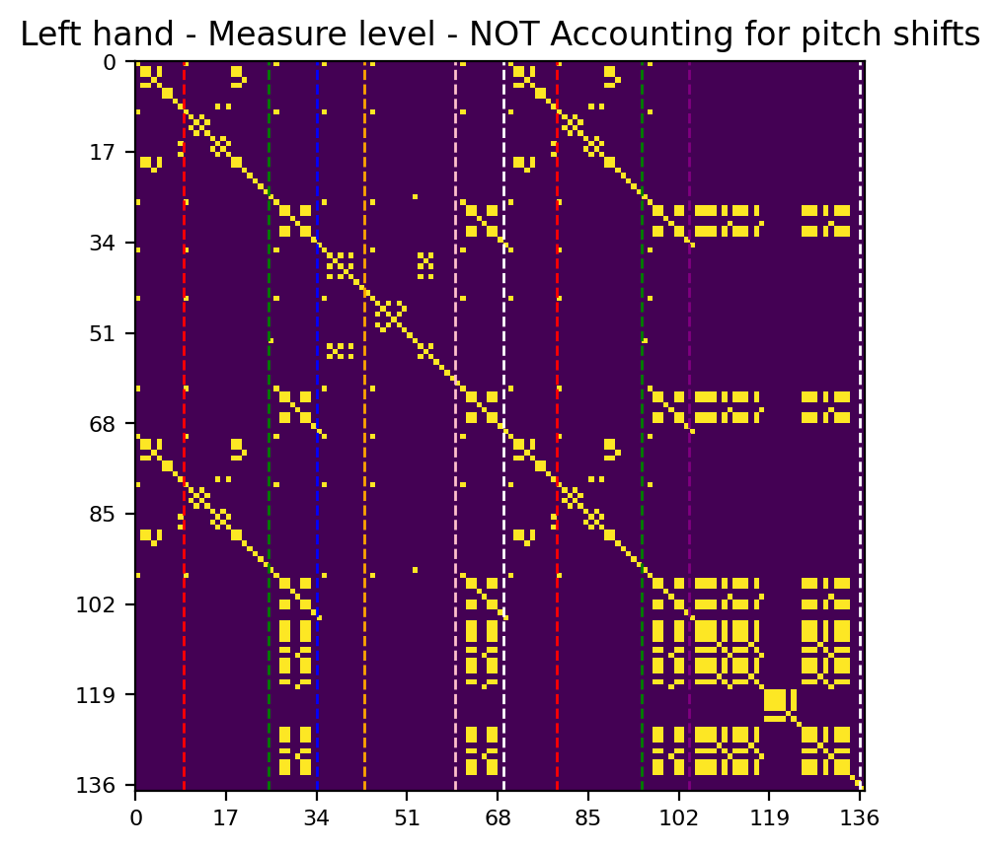

In [56]:
# Create similarity matrix from MIDI measure lists
left_self_sim_mat2 = calculate_ssm(left_midi_measure_sequence)

# Number of measures
num_measures = len(left_midi_measure_sequence)

# Set ticks dynamically based on the number of measures
tick_positions = range(0, num_measures + 1, max(1, num_measures // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_measures()

plt.imshow(left_self_sim_mat2, cmap='viridis', interpolation='nearest', extent=[0, num_measures, num_measures, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Left hand - Measure level - NOT Accounting for pitch shifts")
plt.show()

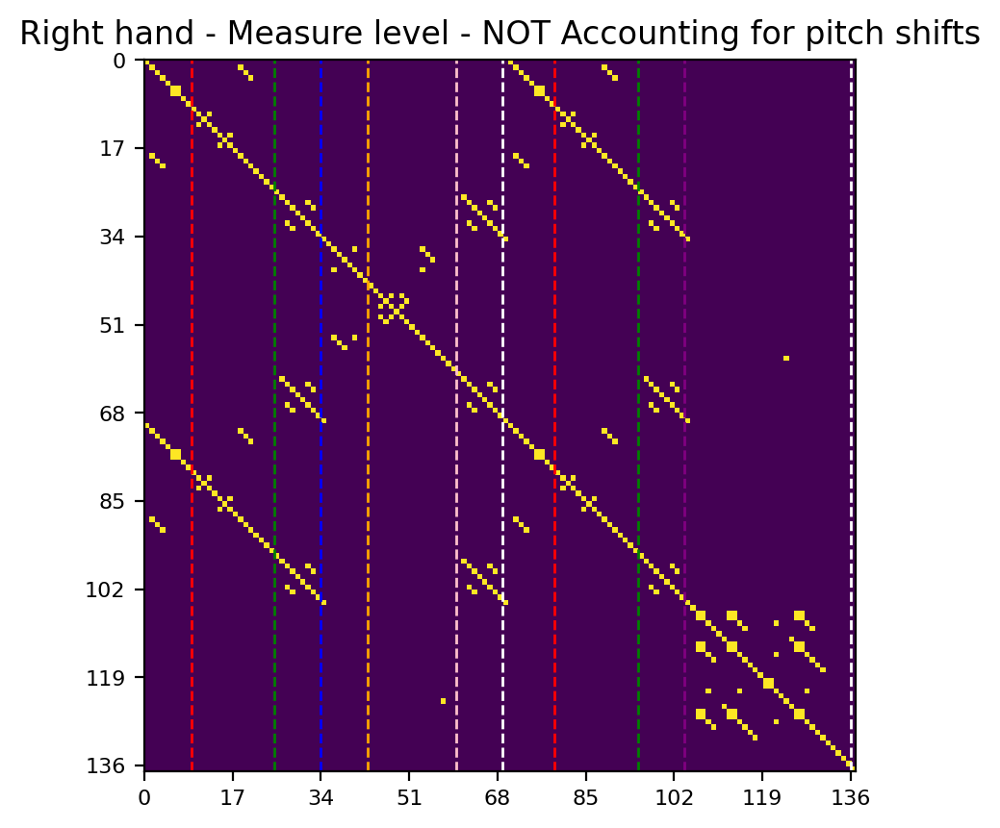

In [57]:
# Create similarity matrix from MIDI measure lists
right_self_sim_mat2 = calculate_ssm(right_midi_measure_sequence)

# Number of measures
num_measures = len(right_midi_measure_sequence)

# Set ticks dynamically based on the number of measures
tick_positions = range(0, num_measures + 1, max(1, num_measures // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

# Add lines
drawlines_measures()

plt.imshow(right_self_sim_mat2, cmap='viridis', interpolation='nearest', extent=[0, num_measures, num_measures, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Right hand - Measure level - NOT Accounting for pitch shifts")
plt.show()

### Considering pitch transposition when computing the similarity

In [58]:
# Kronecker function with transposition check
def kronecker_delta_transinvar(x, y):
    # Check if both sequences are empty, or if one is empty
    if not x and not y:
        return 1  # Consider two empty sequences as similar
    if not x or not y:
        return 0  # If one is empty and the other is not, they are not similar

    if x == y:
        return 1
    if len(x) != len(y):
        return 0

    # Calculate the difference between corresponding elements
    diff_list = [from_y - from_x for from_x, from_y in zip(x, y)]

    # Check if all differences are the same (indicating a transposition)
    if all(diff == diff_list[0] for diff in diff_list):
        return 0.5
    return 0


# Create TI distance matrix from MIDI measure lists, reflecting equality under transposition
def calculate_ti_ssm(sequence):
    length = len(sequence)
    ti_ssm = np.zeros((length, length))

    i = 0
    for element_i in sequence:
        j = 0
        for element_j in sequence:
            ti_ssm[i][j] = kronecker_delta_transinvar(element_i, element_j)
            j += 1
        i += 1

    return ti_ssm


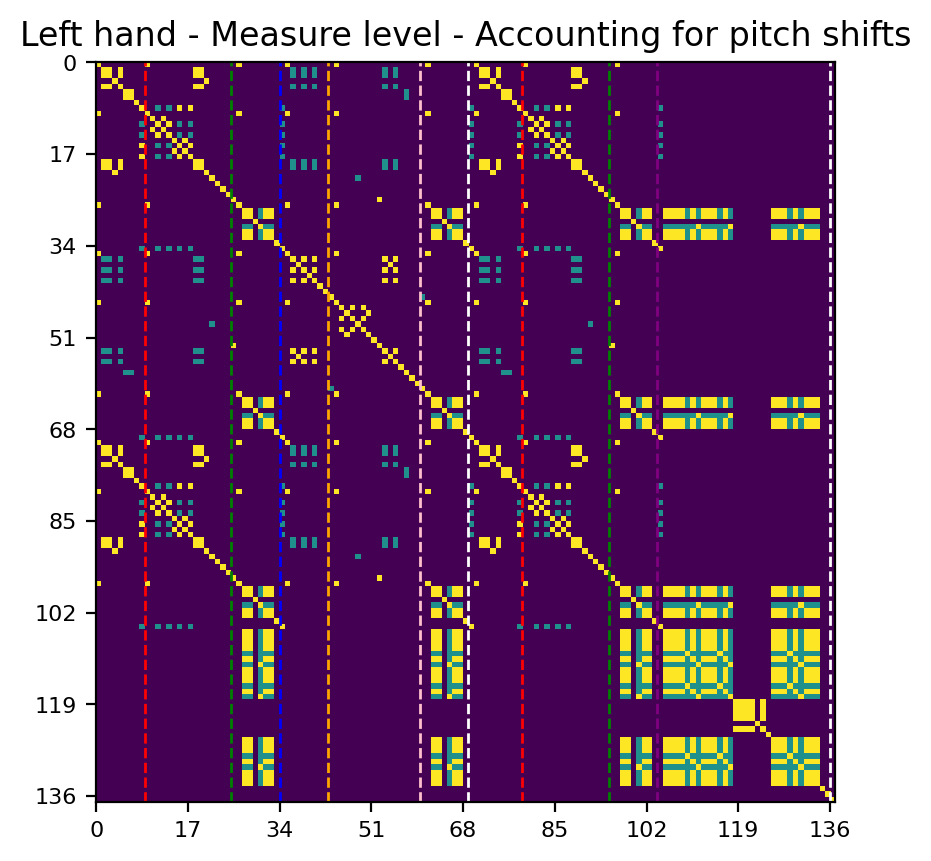

In [59]:
left_self_sim_mat3 = calculate_ti_ssm(left_midi_measure_sequence)

# Number of measures
num_measures = len(left_midi_measure_sequence)

# Set ticks dynamically based on the number of measures
tick_positions = range(0, num_measures + 1, max(1, num_measures // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_measures()

plt.imshow(left_self_sim_mat3, cmap='viridis', interpolation='nearest', extent=[0, num_measures, num_measures, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Left hand - Measure level - Accounting for pitch shifts")
plt.show()

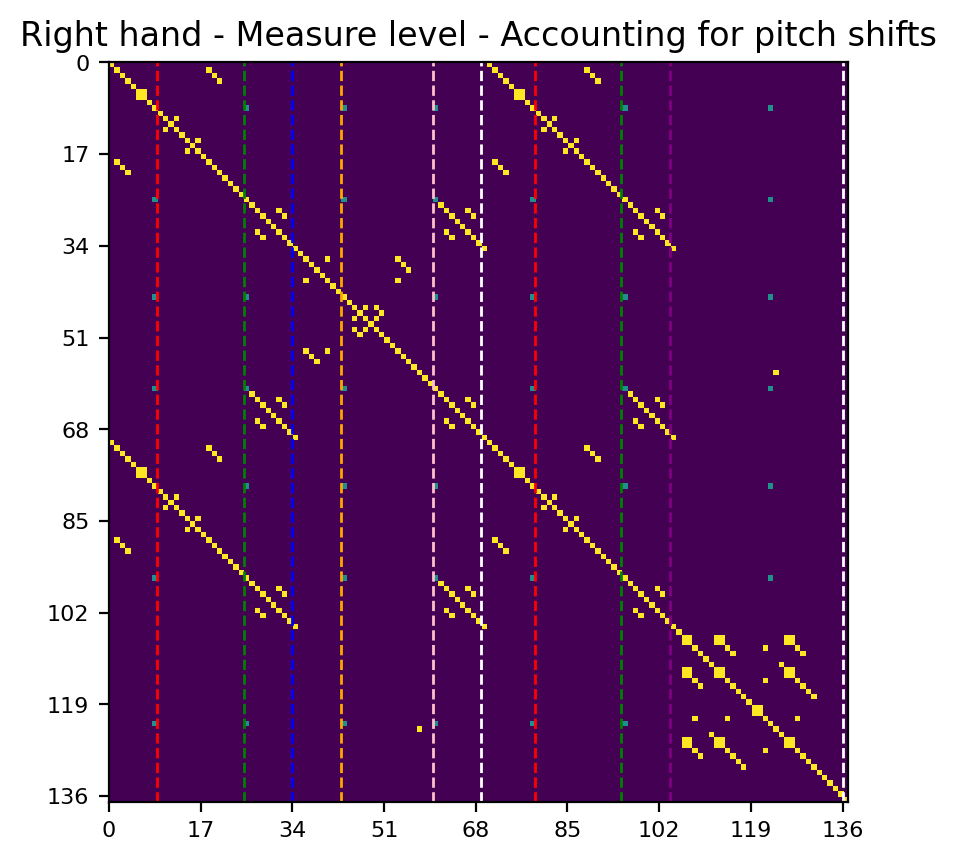

In [60]:
right_self_sim_mat3 = calculate_ti_ssm(right_midi_measure_sequence)

# Number of measures
num_measures = len(right_midi_measure_sequence)

# Set ticks dynamically based on the number of measures
tick_positions = range(0, num_measures + 1, max(1, num_measures // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_measures()

plt.imshow(right_self_sim_mat3, cmap='viridis', interpolation='nearest', extent=[0, num_measures, num_measures, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Right hand - Measure level - Accounting for pitch shifts")
plt.show()

## SSM for the individual beats
As many measures follow similar patterns, but with different intervals between their inner beats, computing the similarities between the measures may not be enough. For this reason, we started working at a beat level.

In [61]:
right_midi_beat_sequence = []
left_midi_beat_sequence = []

# Iterate through each measure and then each note
for measure in right_hand.getElementsByClass(stream.Measure):
    for event in measure.recurse().notes:
        start_time = event.offset + measure.number * measure.barDuration.quarterLength  # Calculate start time in "quarters"
        beat_number = int(start_time)  # Convert start time to an integer to get the beat number

        # Initialize the list for this beat number if it doesn't exist
        if len(right_midi_beat_sequence) <= beat_number:
            right_midi_beat_sequence.extend([[] for _ in range(beat_number - len(right_midi_beat_sequence) + 1)])

        # Append MIDI note numbers to the corresponding beat
        if event.isNote:
            right_midi_beat_sequence[beat_number].append(event.pitch.midi)
        elif event.isChord:
            for note in event.notes:
                right_midi_beat_sequence[beat_number].append(note.pitch.midi)

for measure in left_hand.getElementsByClass(stream.Measure):
    for event in measure.recurse().notes:
        start_time = event.offset + measure.number * measure.barDuration.quarterLength  # Calculate start time in "quarters"
        beat_number = int(start_time)  # Convert start time to an integer to get the beat number

        # Initialize the list for this beat number if it doesn't exist
        if len(left_midi_beat_sequence) <= beat_number:
            left_midi_beat_sequence.extend([[] for _ in range(beat_number - len(left_midi_beat_sequence) + 1)])

        # Append MIDI note numbers to the corresponding beat
        if event.isNote:
            left_midi_beat_sequence[beat_number].append(event.pitch.midi)
        elif event.isChord:
            for note in event.notes:
                left_midi_beat_sequence[beat_number].append(note.pitch.midi)


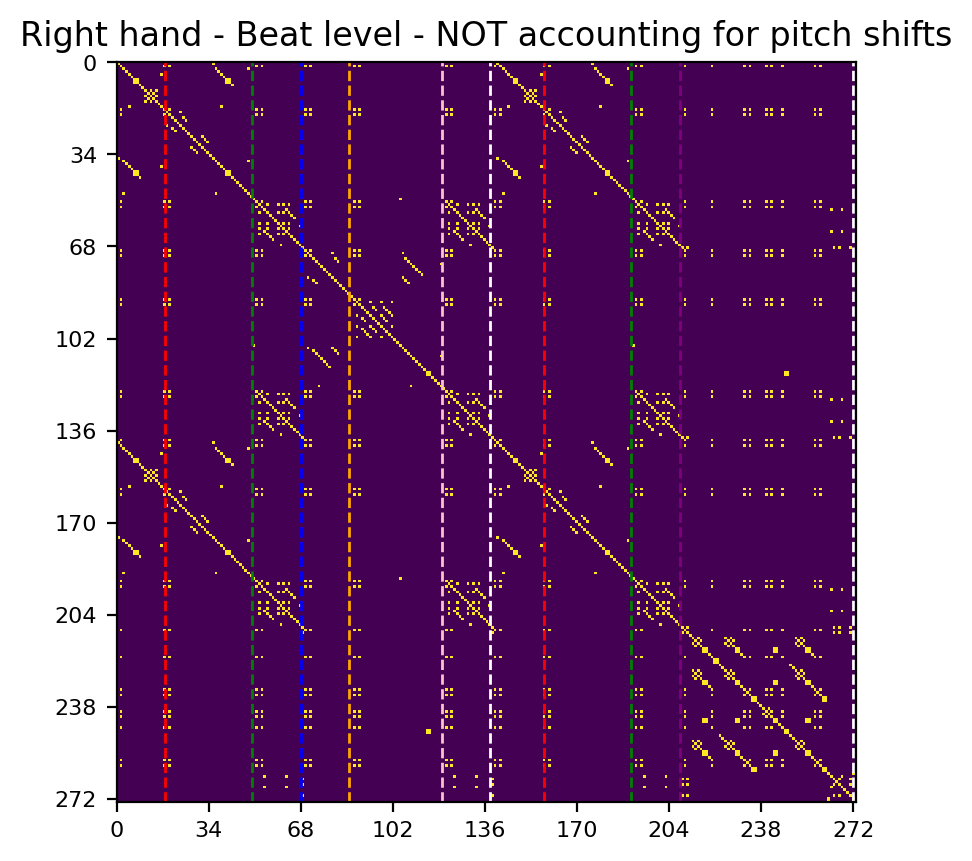

In [62]:
# Create similarity matrix from MIDI beat lists
right_self_sim_mat2 = calculate_ssm(right_midi_beat_sequence)

# Number of beats
num_beats = len(right_midi_beat_sequence)

# Set ticks dynamically based on the number of beats
tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_beats()

plt.imshow(right_self_sim_mat2, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Right hand - Beat level - NOT accounting for pitch shifts")
plt.show()


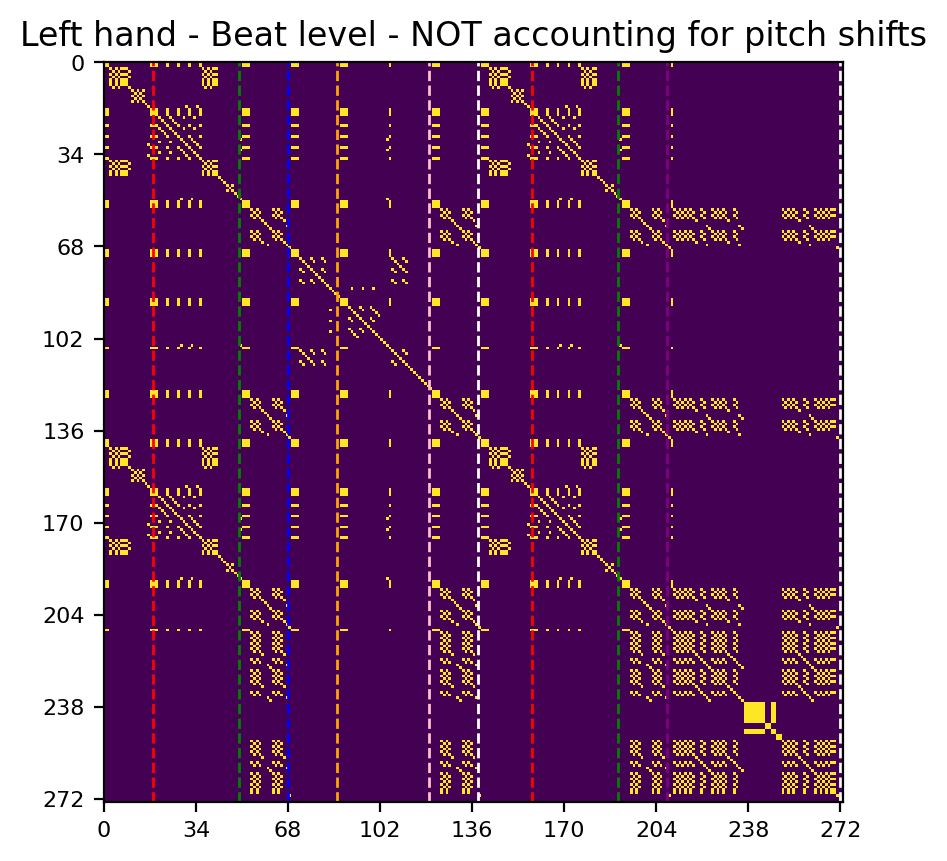

In [63]:

# Create similarity matrix from MIDI beat lists
left_self_sim_mat2 = calculate_ssm(left_midi_beat_sequence)

# Number of beats
num_beats = len(left_midi_beat_sequence)

# Set ticks dynamically based on the number of beats
tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_beats()

plt.imshow(left_self_sim_mat2, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Left hand - Beat level - NOT accounting for pitch shifts")
plt.show()


### Accounting for pitch transposition (imperfect similarity in blue)

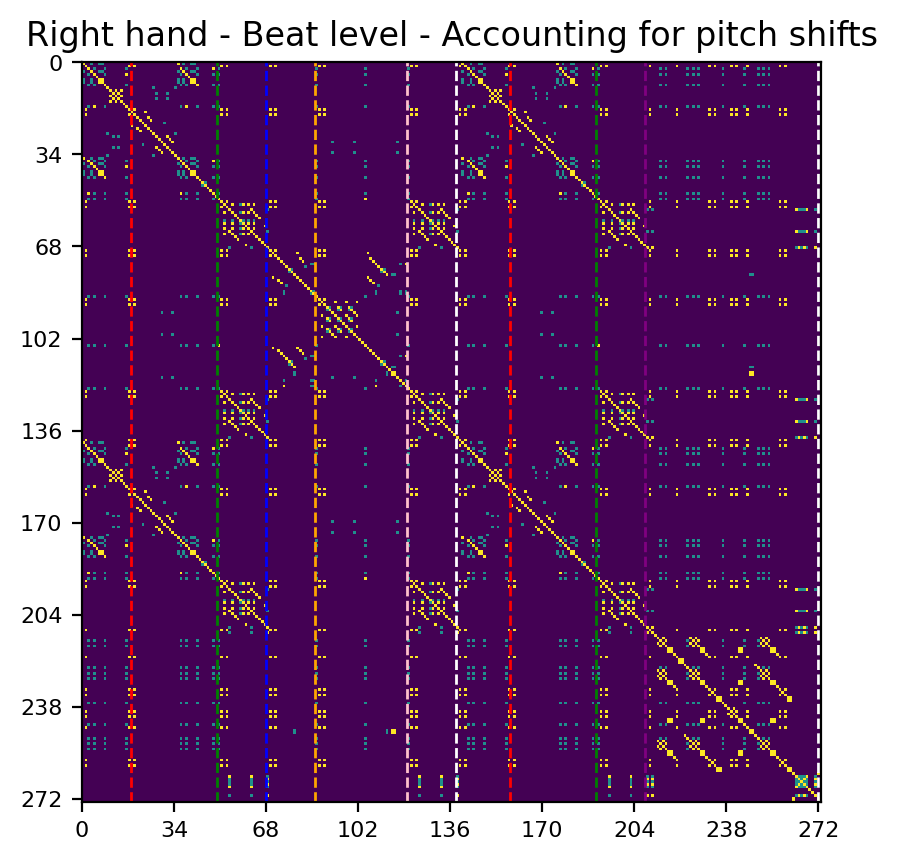

In [64]:

# Create similarity matrix from MIDI beat lists
right_self_sim_mat3 = calculate_ti_ssm(right_midi_beat_sequence)

# Number of beats
num_beats = len(right_midi_beat_sequence)

# Set ticks dynamically based on the number of beats
tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_beats()

plt.imshow(right_self_sim_mat3, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Right hand - Beat level - Accounting for pitch shifts")
plt.show()


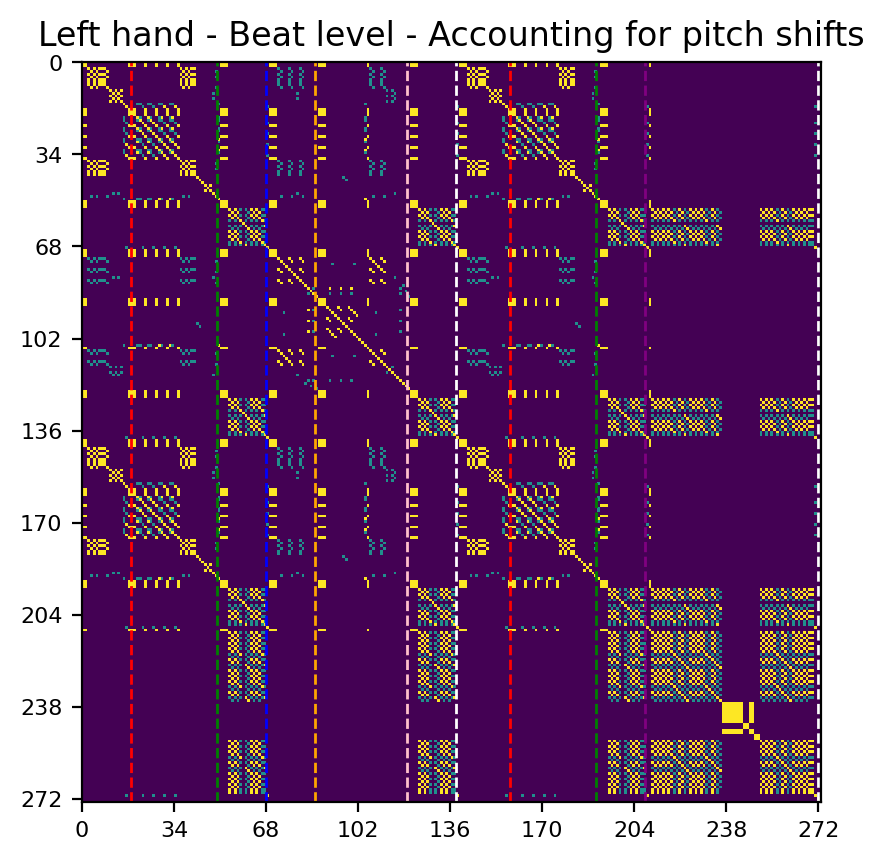

In [65]:

# Create similarity matrix from MIDI beat lists
left_self_sim_mat3 = calculate_ti_ssm(left_midi_beat_sequence)

# Number of beats
num_beats = len(left_midi_beat_sequence)

# Set ticks dynamically based on the number of beats
tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_beats()

plt.imshow(left_self_sim_mat3, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Left hand - Beat level - Accounting for pitch shifts")
plt.show()


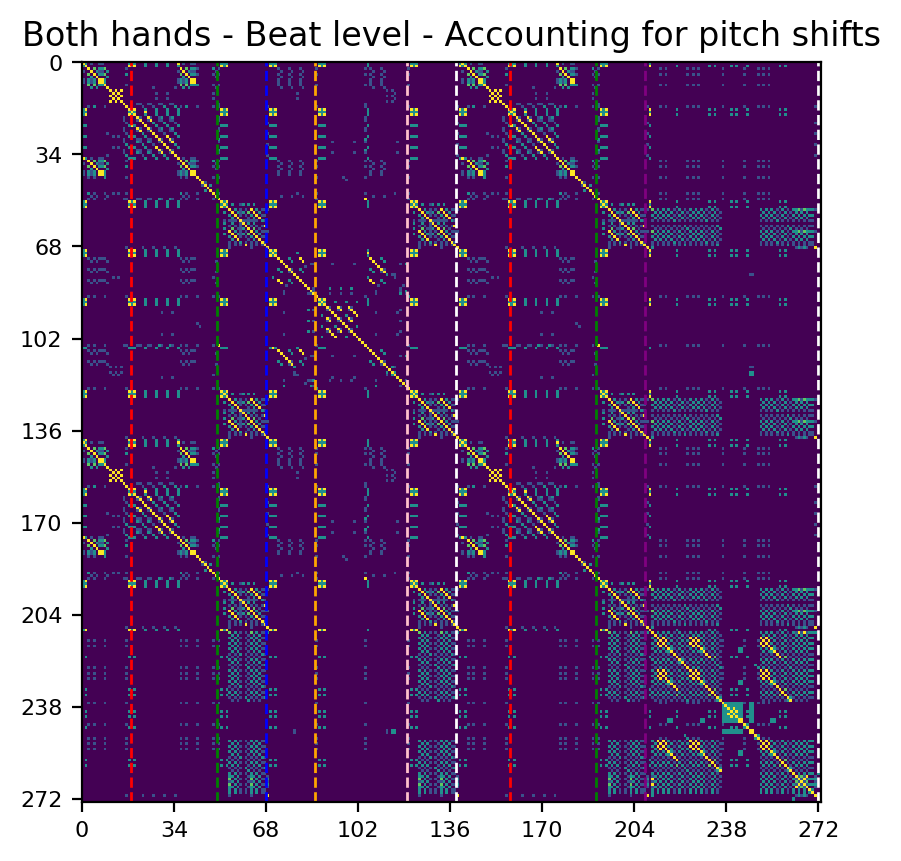

In [66]:
total_ssm = left_self_sim_mat3 + right_self_sim_mat3
# Number of beats
num_beats = len(total_ssm)

# Set ticks dynamically based on the number of beats
tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
tick_labels = [str(i) for i in tick_positions]

drawlines_beats()

plt.imshow(total_ssm, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
plt.xticks(tick_positions, tick_labels, fontsize=8)
plt.yticks(tick_positions, tick_labels, fontsize=8)
plt.title("Both hands - Beat level - Accounting for pitch shifts")
plt.show()


# Phrase detection

In [67]:
def extract_score_attributes(part):
    score_data = []
    for element in part.flat.notes:
        if isinstance(element, music21.note.Note):
            attributes = {
                'offset': element.offset,
                'pitch': element.pitch.midi,
                'duration': element.quarterLength,
                'measure': element.measureNumber
            }
            score_data.append(attributes)
        elif isinstance(element, music21.chord.Chord):
            for note in element.notes:
                attributes = {
                    'offset': element.offset,
                    'pitch': note.pitch.midi,
                    'duration': element.quarterLength,
                    'measure': element.measureNumber
                }
                score_data.append(attributes)
    return score_data

def model_P_unperformed_score(ssm, part, similarity_threshold=0.55):
    num_beats = ssm.shape[0]
    phrases = []
    current_phrase_start = 0

    for i in range(1, num_beats):
        max_similarity = np.max(ssm[i, :i])
        measure_number = int(i / 2)  # assuming each measure has 2 beats

        # Check for final bar or repetition
        measure = part.measure(measure_number + 1)
        phrase_ended = False
        if measure:
            for element in measure.elements:
                if isinstance(element, music21.bar.Barline):
                    if element.style in ['final', 'regular', 'dotted', 'heavy']:
                        phrases.append([current_phrase_start, i])
                        current_phrase_start = i + 1
                        phrase_ended = True
                        break

        if max_similarity < similarity_threshold and not phrase_ended:
            phrases.append([current_phrase_start, i - 1])
            current_phrase_start = i

    # Ensure the last phrase is added if it wasn't
    if current_phrase_start < num_beats:
        phrases.append([current_phrase_start, num_beats - 1])

    # Merge short phrases with the following one
    merged_phrases = []
    i = 0
    while i < len(phrases):
        start_beat, end_beat = phrases[i]
        while end_beat - start_beat + 1 < 5 and i < len(phrases) - 1:
            i += 1
            next_start_beat, next_end_beat = phrases[i]
            end_beat = next_end_beat
        merged_phrases.append([start_beat, end_beat])
        i += 1

    return merged_phrases


def print_phrases(phrases):
    for i, phrase in enumerate(phrases):
        print(f"Phrase {i+1}: starts at beat {phrase[0]} and ends at beat {phrase[1]}")

In [68]:
right_hand_score = extract_score_attributes(right_hand)
left_hand_score = extract_score_attributes(left_hand)

In [69]:
# Detect phrases using the total self-similarity matrix and the notation
phrases_total_ssm_and_notation = model_P_unperformed_score(total_ssm, right_hand)

# Print the phrases
print_phrases(phrases_total_ssm_and_notation)

differences = [y - x for x, y in phrases_total_ssm_and_notation]
max_diff, min_diff, avg_diff = max(differences), min(differences), sum(differences) / len(differences)

print(f"\nMax: {max_diff}, Min: {min_diff}, Avg: {avg_diff}")

Phrase 1: starts at beat 0 and ends at beat 9
Phrase 2: starts at beat 10 and ends at beat 14
Phrase 3: starts at beat 15 and ends at beat 19
Phrase 4: starts at beat 20 and ends at beat 27
Phrase 5: starts at beat 28 and ends at beat 42
Phrase 6: starts at beat 43 and ends at beat 48
Phrase 7: starts at beat 49 and ends at beat 53
Phrase 8: starts at beat 54 and ends at beat 59
Phrase 9: starts at beat 60 and ends at beat 67
Phrase 10: starts at beat 68 and ends at beat 72
Phrase 11: starts at beat 73 and ends at beat 77
Phrase 12: starts at beat 78 and ends at beat 82
Phrase 13: starts at beat 83 and ends at beat 89
Phrase 14: starts at beat 90 and ends at beat 95
Phrase 15: starts at beat 96 and ends at beat 101
Phrase 16: starts at beat 102 and ends at beat 112
Phrase 17: starts at beat 113 and ends at beat 117
Phrase 18: starts at beat 118 and ends at beat 235
Phrase 19: starts at beat 236 and ends at beat 243
Phrase 20: starts at beat 244 and ends at beat 272

Max: 117, Min: 4, A

In [70]:
# Detect phrases using the total self-similarity matrix and the notation
phrases_total_ssm_and_notation = model_P_unperformed_score(total_ssm, right_hand, similarity_threshold=0.5)

# Print the phrases
print_phrases(phrases_total_ssm_and_notation)

Phrase 1: starts at beat 0 and ends at beat 9
Phrase 2: starts at beat 10 and ends at beat 14
Phrase 3: starts at beat 15 and ends at beat 42
Phrase 4: starts at beat 43 and ends at beat 53
Phrase 5: starts at beat 54 and ends at beat 73
Phrase 6: starts at beat 74 and ends at beat 82
Phrase 7: starts at beat 83 and ends at beat 89
Phrase 8: starts at beat 90 and ends at beat 101
Phrase 9: starts at beat 102 and ends at beat 112
Phrase 10: starts at beat 113 and ends at beat 272


# Phrases for other pieces in the corpus

Processing file: xml_score81.musicxml


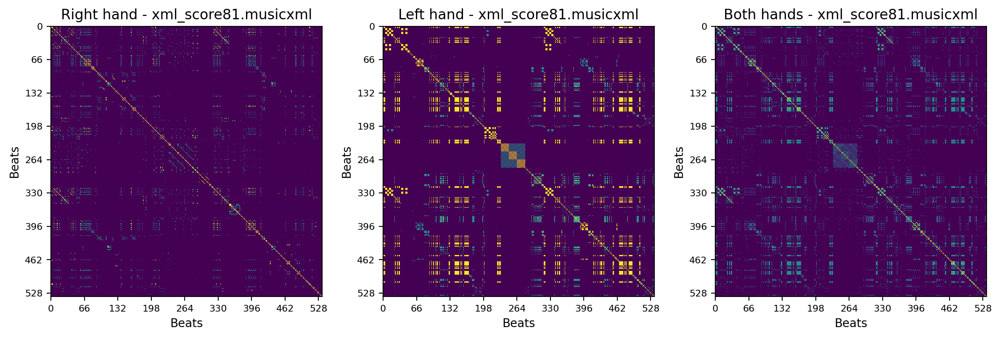

Phrase 1: starts at beat 0 and ends at beat 7
Phrase 2: starts at beat 8 and ends at beat 19
Phrase 3: starts at beat 20 and ends at beat 24
Phrase 4: starts at beat 25 and ends at beat 32
Phrase 5: starts at beat 33 and ends at beat 47
Phrase 6: starts at beat 48 and ends at beat 53
Phrase 7: starts at beat 54 and ends at beat 59
Phrase 8: starts at beat 60 and ends at beat 65
Phrase 9: starts at beat 66 and ends at beat 79
Phrase 10: starts at beat 80 and ends at beat 85
Phrase 11: starts at beat 86 and ends at beat 91
Phrase 12: starts at beat 92 and ends at beat 97
Phrase 13: starts at beat 98 and ends at beat 103
Phrase 14: starts at beat 104 and ends at beat 109
Phrase 15: starts at beat 110 and ends at beat 115
Phrase 16: starts at beat 116 and ends at beat 127
Phrase 17: starts at beat 128 and ends at beat 135
Phrase 18: starts at beat 136 and ends at beat 149
Phrase 19: starts at beat 150 and ends at beat 155
Phrase 20: starts at beat 156 and ends at beat 168
Phrase 21: starts

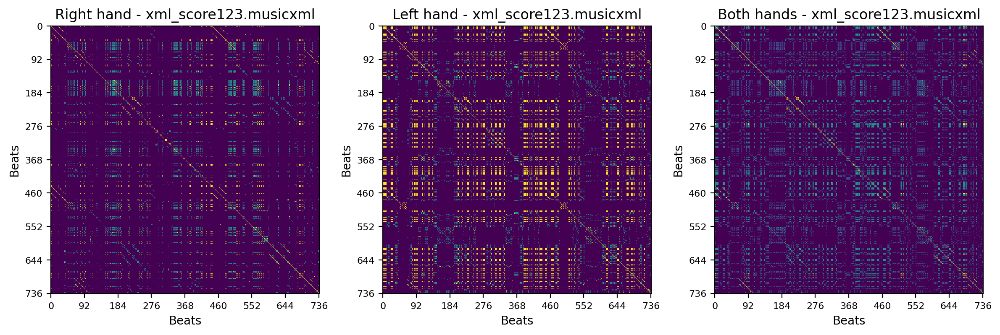

Phrase 1: starts at beat 0 and ends at beat 9
Phrase 2: starts at beat 10 and ends at beat 14
Phrase 3: starts at beat 15 and ends at beat 35
Phrase 4: starts at beat 36 and ends at beat 41
Phrase 5: starts at beat 42 and ends at beat 47
Phrase 6: starts at beat 48 and ends at beat 63
Phrase 7: starts at beat 64 and ends at beat 68
Phrase 8: starts at beat 69 and ends at beat 74
Phrase 9: starts at beat 75 and ends at beat 90
Phrase 10: starts at beat 91 and ends at beat 95
Phrase 11: starts at beat 96 and ends at beat 104
Phrase 12: starts at beat 105 and ends at beat 111
Phrase 13: starts at beat 112 and ends at beat 116
Phrase 14: starts at beat 117 and ends at beat 121
Phrase 15: starts at beat 122 and ends at beat 126
Phrase 16: starts at beat 127 and ends at beat 131
Phrase 17: starts at beat 132 and ends at beat 137
Phrase 18: starts at beat 138 and ends at beat 143
Phrase 19: starts at beat 144 and ends at beat 151
Phrase 20: starts at beat 152 and ends at beat 165
Phrase 21: s

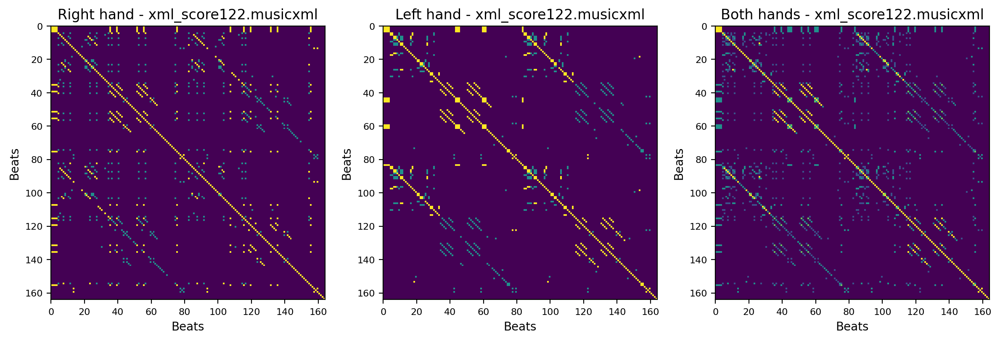

Phrase 1: starts at beat 0 and ends at beat 5
Phrase 2: starts at beat 6 and ends at beat 11
Phrase 3: starts at beat 12 and ends at beat 17
Phrase 4: starts at beat 18 and ends at beat 27
Phrase 5: starts at beat 28 and ends at beat 33
Phrase 6: starts at beat 34 and ends at beat 45
Phrase 7: starts at beat 46 and ends at beat 64
Phrase 8: starts at beat 65 and ends at beat 69
Phrase 9: starts at beat 70 and ends at beat 75
Phrase 10: starts at beat 76 and ends at beat 80
Phrase 11: starts at beat 81 and ends at beat 103
Phrase 12: starts at beat 104 and ends at beat 122
Phrase 13: starts at beat 123 and ends at beat 127
Phrase 14: starts at beat 128 and ends at beat 137
Phrase 15: starts at beat 138 and ends at beat 147
Phrase 16: starts at beat 148 and ends at beat 155
Phrase 17: starts at beat 156 and ends at beat 160
Phrase 18: starts at beat 161 and ends at beat 163
Max: 22, Min: 2, Avg: 8.11111111111111, Tuple with longest difference: [81, 103]


Processing file: xml_score.music

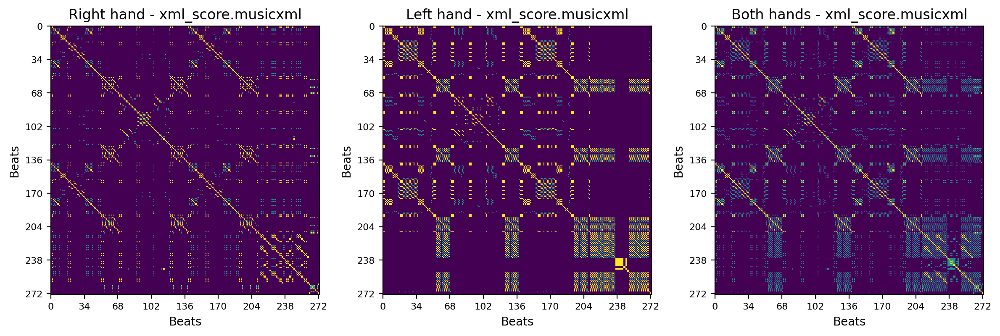

Phrase 1: starts at beat 0 and ends at beat 9
Phrase 2: starts at beat 10 and ends at beat 14
Phrase 3: starts at beat 15 and ends at beat 19
Phrase 4: starts at beat 20 and ends at beat 27
Phrase 5: starts at beat 28 and ends at beat 42
Phrase 6: starts at beat 43 and ends at beat 48
Phrase 7: starts at beat 49 and ends at beat 53
Phrase 8: starts at beat 54 and ends at beat 59
Phrase 9: starts at beat 60 and ends at beat 67
Phrase 10: starts at beat 68 and ends at beat 72
Phrase 11: starts at beat 73 and ends at beat 77
Phrase 12: starts at beat 78 and ends at beat 82
Phrase 13: starts at beat 83 and ends at beat 89
Phrase 14: starts at beat 90 and ends at beat 95
Phrase 15: starts at beat 96 and ends at beat 101
Phrase 16: starts at beat 102 and ends at beat 112
Phrase 17: starts at beat 113 and ends at beat 117
Phrase 18: starts at beat 118 and ends at beat 235
Phrase 19: starts at beat 236 and ends at beat 243
Phrase 20: starts at beat 244 and ends at beat 272
Max: 117, Min: 4, Av

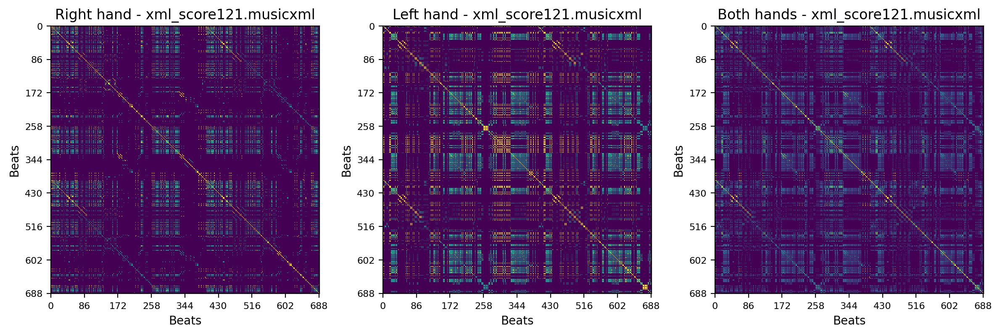

Phrase 1: starts at beat 0 and ends at beat 5
Phrase 2: starts at beat 6 and ends at beat 11
Phrase 3: starts at beat 12 and ends at beat 23
Phrase 4: starts at beat 24 and ends at beat 37
Phrase 5: starts at beat 38 and ends at beat 44
Phrase 6: starts at beat 45 and ends at beat 61
Phrase 7: starts at beat 62 and ends at beat 67
Phrase 8: starts at beat 68 and ends at beat 74
Phrase 9: starts at beat 75 and ends at beat 93
Phrase 10: starts at beat 94 and ends at beat 99
Phrase 11: starts at beat 100 and ends at beat 105
Phrase 12: starts at beat 106 and ends at beat 110
Phrase 13: starts at beat 111 and ends at beat 117
Phrase 14: starts at beat 118 and ends at beat 122
Phrase 15: starts at beat 123 and ends at beat 129
Phrase 16: starts at beat 130 and ends at beat 135
Phrase 17: starts at beat 136 and ends at beat 143
Phrase 18: starts at beat 144 and ends at beat 170
Phrase 19: starts at beat 171 and ends at beat 182
Phrase 20: starts at beat 183 and ends at beat 191
Phrase 21: s

In [71]:
xml_directory = 'xml'

for filename in os.listdir(xml_directory):
    if filename.endswith('.musicxml'):
        print(f"Processing file: {filename}")
        sample_score = converter.parse(xml_directory + '/' + filename) # converter is from the music21 package

        right_hand = sample_score.parts[0]  # Assuming the right hand is the first part
        right_hand_notes = [note for note in right_hand.recurse().notes]



        left_hand = sample_score.parts[1]  # Assuming the right hand is the first part
        left_hand_notes = [note for note in right_hand.recurse().notes]

        
        right_midi_beat_sequence = []
        left_midi_beat_sequence = []

        # Iterate through each measure and then each note
        for measure in right_hand.getElementsByClass(stream.Measure):
            for event in measure.recurse().notes:
                start_time = event.offset + measure.number * measure.barDuration.quarterLength  # Calculate start time in "quarters"
                beat_number = int(start_time)  # Convert start time to an integer to get the beat number

                # Initialize the list for this beat number if it doesn't exist
                if len(right_midi_beat_sequence) <= beat_number:
                    right_midi_beat_sequence.extend([[] for _ in range(beat_number - len(right_midi_beat_sequence) + 1)])

                # Append MIDI note numbers to the corresponding beat
                if event.isNote:
                    right_midi_beat_sequence[beat_number].append(event.pitch.midi)
                elif event.isChord:
                    for note in event.notes:
                        right_midi_beat_sequence[beat_number].append(note.pitch.midi)

        for measure in left_hand.getElementsByClass(stream.Measure):
            for event in measure.recurse().notes:
                start_time = event.offset + measure.number * measure.barDuration.quarterLength  # Calculate start time in "quarters"
                beat_number = int(start_time)  # Convert start time to an integer to get the beat number

                # Initialize the list for this beat number if it doesn't exist
                if len(left_midi_beat_sequence) <= beat_number:
                    left_midi_beat_sequence.extend([[] for _ in range(beat_number - len(left_midi_beat_sequence) + 1)])

                # Append MIDI note numbers to the corresponding beat
                if event.isNote:
                    left_midi_beat_sequence[beat_number].append(event.pitch.midi)
                elif event.isChord:
                    for note in event.notes:
                        left_midi_beat_sequence[beat_number].append(note.pitch.midi)

        plt.figure(figsize=(12, 6))


        # Create similarity matrix from MIDI beat lists
        right_self_sim_mat3 = calculate_ti_ssm(right_midi_beat_sequence)

        # Number of beats
        num_beats = len(right_midi_beat_sequence)

        # Set ticks dynamically based on the number of beats
        tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
        tick_labels = [str(i) for i in tick_positions]

        plt.subplot(1, 3, 1)
        plt.imshow(right_self_sim_mat3, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
        plt.xticks(tick_positions, tick_labels, fontsize=8)
        plt.yticks(tick_positions, tick_labels, fontsize=8)
        plt.title("Right hand - " + filename)
        plt.xlabel('Beats')
        plt.ylabel('Beats')







        # Create similarity matrix from MIDI beat lists
        left_self_sim_mat3 = calculate_ti_ssm(left_midi_beat_sequence)

        # Number of beats
        num_beats = len(left_midi_beat_sequence)

        # Set ticks dynamically based on the number of beats
        tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
        tick_labels = [str(i) for i in tick_positions]

        plt.subplot(1, 3, 2)
        plt.imshow(left_self_sim_mat3, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
        plt.xticks(tick_positions, tick_labels, fontsize=8)
        plt.yticks(tick_positions, tick_labels, fontsize=8)
        plt.title("Left hand - " + filename)
        plt.xlabel('Beats')
        plt.ylabel('Beats')

        total_ssm = left_self_sim_mat3 + right_self_sim_mat3
        # Number of beats
        num_beats = len(total_ssm)

        # Set ticks dynamically based on the number of beats
        tick_positions = range(0, num_beats + 1, max(1, num_beats // 8))  # Adjust the step for readability
        tick_labels = [str(i) for i in tick_positions]

        plt.subplot(1, 3, 3)

        plt.imshow(total_ssm, cmap='viridis', interpolation='nearest', extent=[0, num_beats, num_beats, 0])
        plt.xticks(tick_positions, tick_labels, fontsize=8)
        plt.yticks(tick_positions, tick_labels, fontsize=8)
        plt.title("Both hands - " + filename)
        plt.xlabel('Beats')
        plt.ylabel('Beats')
        plt.tight_layout()
        plt.show()


        # Detect phrases using the total self-similarity matrix and the notation
        phrases_total_ssm_and_notation = model_P_unperformed_score(total_ssm, right_hand)

        # Print the phrases
        print_phrases(phrases_total_ssm_and_notation)

        differences = [y - x for x, y in phrases_total_ssm_and_notation]
        max_diff, min_diff, avg_diff = max(differences), min(differences), sum(differences) / len(differences)
        tuple_with_max_diff = phrases_total_ssm_and_notation[differences.index(max_diff)]

        print(f"Max: {max_diff}, Min: {min_diff}, Avg: {avg_diff}, Tuple with longest difference: {tuple_with_max_diff}")
        print("\n")




# SSM on the spectrograms

In [72]:
file_path = "midi_score.wav"
audio, sampling_rate = librosa.load(file_path)
Audio(audio, rate=sampling_rate)

In [73]:
file_path = "Stahievitch02.wav"
audio, sampling_rate = librosa.load(file_path)
Audio(audio, rate=sampling_rate)

In [74]:
def create_and_chart_spectrogram(audio, sampling_rate, hop_length):
    # Compute the Short-Time Fourier Transform (STFT)
    stft = librosa.stft(audio, hop_length=hop_length)
    spectrogram = np.abs(stft)
    
    # Display the spectrogram
    plt.figure()
    librosa.display.specshow(librosa.amplitude_to_db(spectrogram, ref=np.max), y_axis='log', x_axis='time', sr=sampling_rate, hop_length=hop_length)
    plt.colorbar(format='%+2.0f dB')
    plt.title('Spectrogram derived from STFT')
    plt.show()
    
    return spectrogram

def ssm_from_spectrogram(spectrogram, sampling_rate, hop_length):
    spectrogram_T = spectrogram.T
    spectrogram_T = np.delete(spectrogram_T, np.where((spectrogram_T == 0).all(axis=1))[0], axis=0)
    times = librosa.times_like(spectrogram_T.shape[0], sr=sampling_rate, hop_length=hop_length)
    
    # Calculate the self-similarity matrix using cosine similarity
    self_sim_mat_aud = cosine_similarity(spectrogram_T)
    
    return self_sim_mat_aud, times

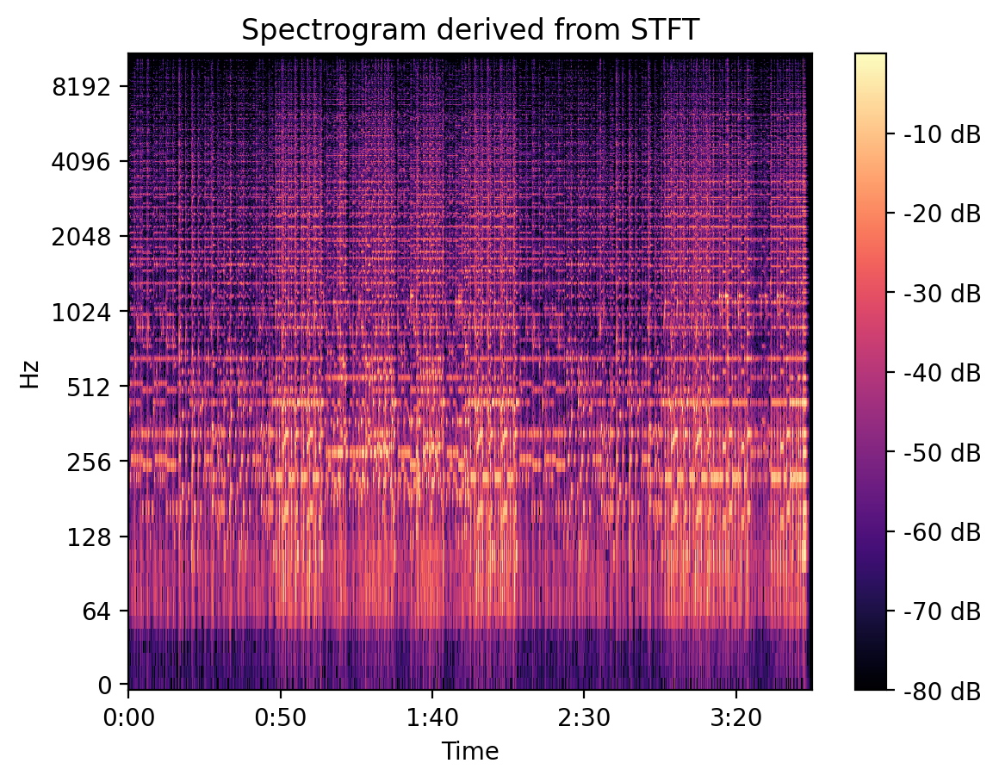

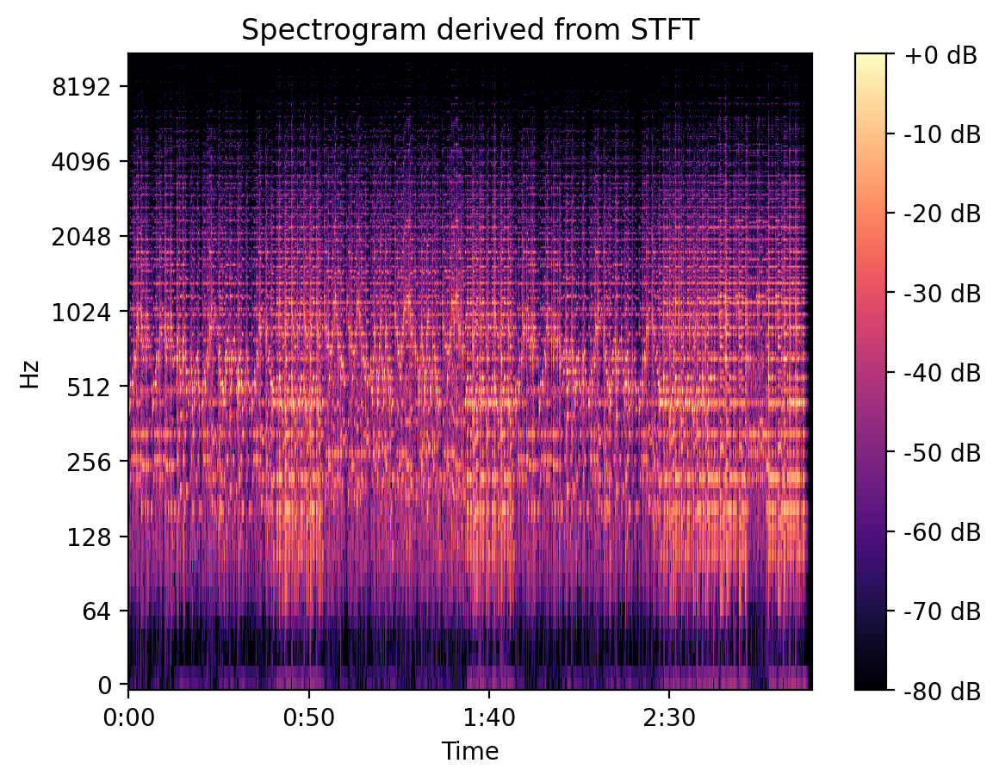

In [75]:

hop_length = 512

# Process first audio file
file_path1 = "midi_score.wav"
audio1, sampling_rate1 = librosa.load(file_path1)
Audio(audio1, rate=sampling_rate1)
spectrogram1 = create_and_chart_spectrogram(audio1, sampling_rate1, hop_length)
self_sim_mat_aud1, times1 = ssm_from_spectrogram(spectrogram1, sampling_rate1, hop_length)

# Process second audio file
file_path2 = "Stahievitch02.wav"
audio2, sampling_rate2 = librosa.load(file_path2)
Audio(audio2, rate=sampling_rate2)
spectrogram2 = create_and_chart_spectrogram(audio2, sampling_rate2, hop_length)
self_sim_mat_aud2, times2 = ssm_from_spectrogram(spectrogram2, sampling_rate2, hop_length)


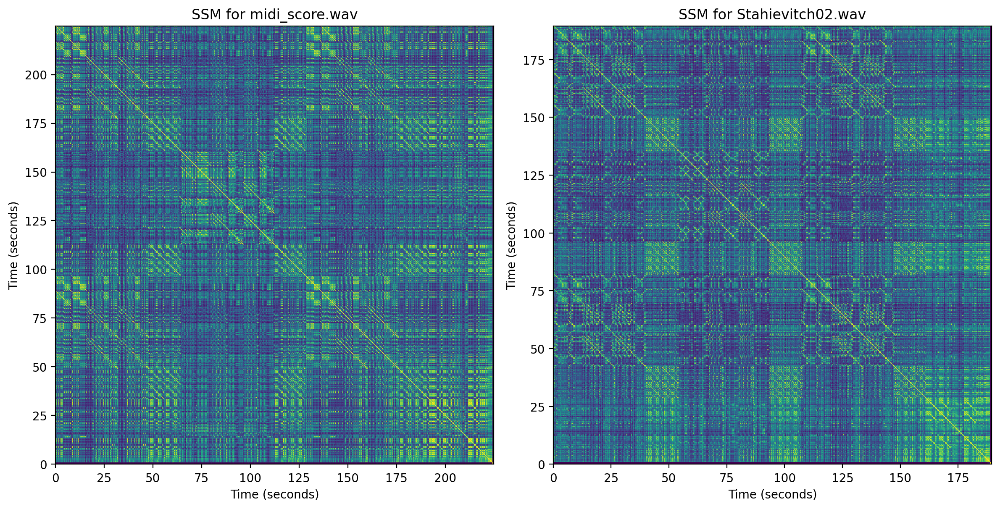

In [76]:

# Plot both SSMs side by side
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(self_sim_mat_aud1, cmap='viridis', interpolation='nearest', extent=[times1[0], times1[-1], times1[0], times1[-1]])
plt.xlabel('Time (seconds)')
plt.ylabel('Time (seconds)')
plt.title('SSM for midi_score.wav')

plt.subplot(1, 2, 2)
plt.imshow(self_sim_mat_aud2, cmap='viridis', interpolation='nearest', extent=[times2[0], times2[-1], times2[0], times2[-1]])
plt.xlabel('Time (seconds)')
plt.ylabel('Time (seconds)')
plt.title('SSM for Stahievitch02.wav')
#plt.colorbar(label='Cosine Similarity')

plt.tight_layout()
plt.show()


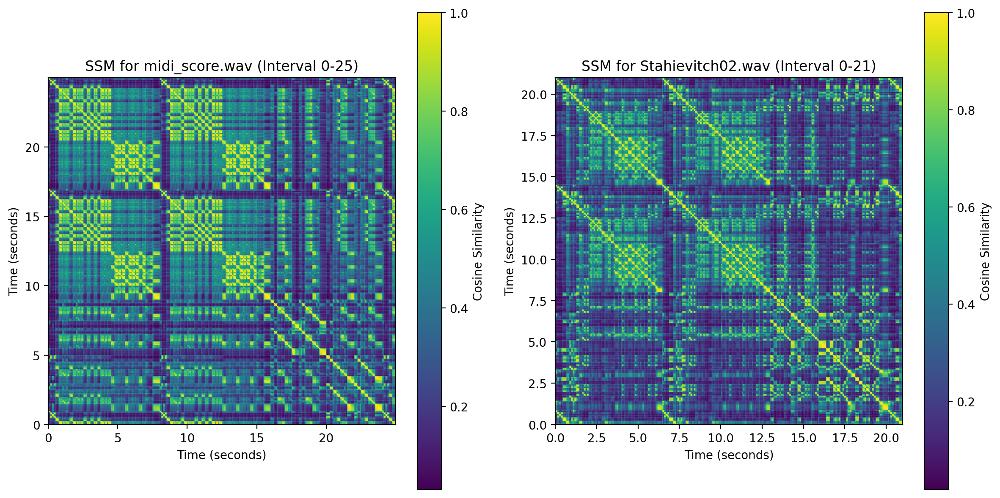

In [77]:
# Define the intervals of interest
interval_start1 = 0
interval_end1 = 25
interval_start2 = 0
interval_end2 = 21

# Determine the indices corresponding to the desired time interval for the first SSM
start_idx1 = np.searchsorted(times1, interval_start1)
end_idx1 = np.searchsorted(times1, interval_end1)

# Determine the indices corresponding to the desired time interval for the second SSM
start_idx2 = np.searchsorted(times2, interval_start2)
end_idx2 = np.searchsorted(times2, interval_end2)

# Extract the submatrices for the specified intervals
submat1 = self_sim_mat_aud1[start_idx1:end_idx1, start_idx1:end_idx1]
subtimes1 = times1[start_idx1:end_idx1]
submat2 = self_sim_mat_aud2[start_idx2:end_idx2, start_idx2:end_idx2]
subtimes2 = times2[start_idx2:end_idx2]

# Plot the submatrices side by side
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(submat1, cmap='viridis', interpolation='nearest', extent=[subtimes1[0], subtimes1[-1], subtimes1[0], subtimes1[-1]])
plt.xlabel('Time (seconds)')
plt.ylabel('Time (seconds)')
plt.title('SSM for midi_score.wav (Interval 0-25)')
plt.colorbar(label='Cosine Similarity')

plt.subplot(1, 2, 2)
plt.imshow(submat2, cmap='viridis', interpolation='nearest', extent=[subtimes2[0], subtimes2[-1], subtimes2[0], subtimes2[-1]])
plt.xlabel('Time (seconds)')
plt.ylabel('Time (seconds)')
plt.title('SSM for Stahievitch02.wav (Interval 0-21)')
plt.colorbar(label='Cosine Similarity')

plt.tight_layout()
plt.show()

# Appendix

[{'offset': 0.0, 'pitch': 65, 'duration': 2.0, 'measure': 1}, {'offset': 2.0, 'pitch': 69, 'duration': 1.0, 'measure': 1}, {'offset': 3.0, 'pitch': 72, 'duration': 2.0, 'measure': 2}, {'offset': 5.0, 'pitch': 69, 'duration': 1.0, 'measure': 2}, {'offset': 6.0, 'pitch': 70, 'duration': 2.0, 'measure': 3}, {'offset': 8.0, 'pitch': 79, 'duration': 1.0, 'measure': 3}, {'offset': 9.0, 'pitch': 77, 'duration': 0.5, 'measure': 4}, {'offset': 9.5, 'pitch': 76, 'duration': 0.5, 'measure': 4}, {'offset': 10.0, 'pitch': 76, 'duration': 1.0, 'measure': 4}, {'offset': 12.0, 'pitch': 77, 'duration': 1.0, 'measure': 5}, {'offset': 13.0, 'pitch': 69, 'duration': 1.0, 'measure': 5}, {'offset': 14.0, 'pitch': 74, 'duration': 1.0, 'measure': 5}, {'offset': 15.0, 'pitch': 67, 'duration': 1.0, 'measure': 6}, {'offset': 16.0, 'pitch': 72, 'duration': 1.5, 'measure': 6}, {'offset': 17.5, 'pitch': 69, 'duration': 0.5, 'measure': 6}, {'offset': 18.0, 'pitch': 65, 'duration': 3.0, 'measure': 7}, {'offset': 21.0

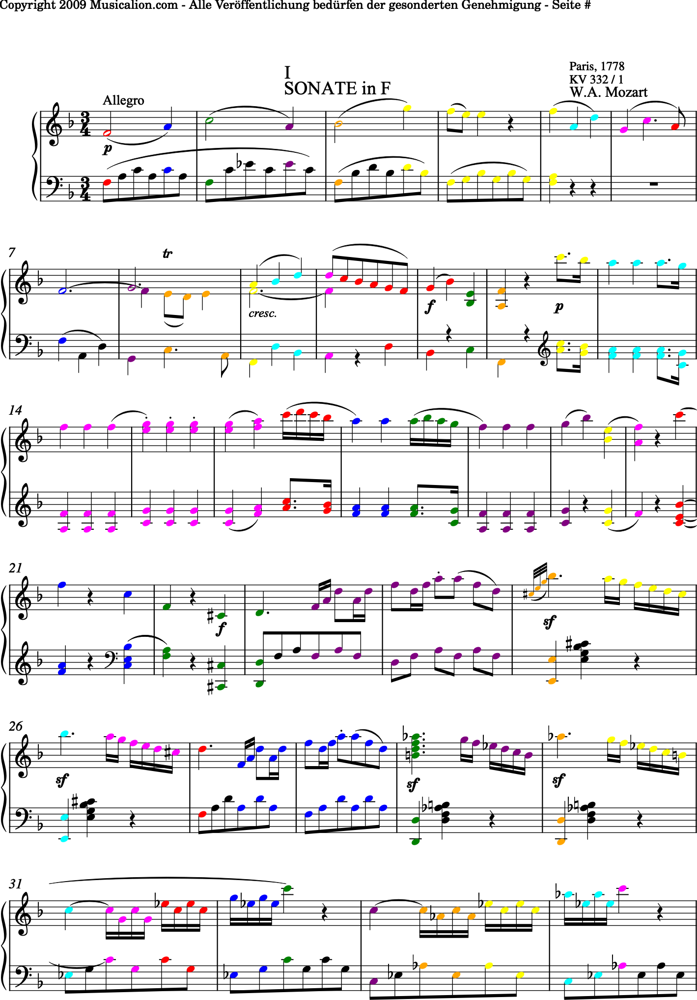

In [78]:
def extract_score_attributes(part):
    score_data = []
    for element in part.flat.notes:
        if isinstance(element, music21.note.Note):
            attributes = {
                'offset': element.offset,
                'pitch': element.pitch.midi,
                'duration': element.quarterLength,
                'measure': element.measureNumber
            }
            score_data.append(attributes)
        elif isinstance(element, music21.chord.Chord):
            for note in element.notes:
                attributes = {
                    'offset': element.offset,
                    'pitch': note.pitch.midi,
                    'duration': element.quarterLength,
                    'measure': element.measureNumber
                }
                score_data.append(attributes)
    print(score_data)
    return score_data

def detect_phrases_score(score_data, pitch_threshold=5, duration_threshold=0.5):
    phrases = []
    current_phrase = [score_data[0]['offset']]
    for i in range(1, len(score_data)):
        pitch_change = np.abs(score_data[i]['pitch'] - score_data[i - 1]['pitch'])
        duration_change = np.abs(score_data[i]['duration'] - score_data[i - 1]['duration'])
        if pitch_change > pitch_threshold or duration_change > duration_threshold:
            current_phrase.append(score_data[i - 1]['offset'])
            phrases.append(current_phrase)
            current_phrase = [score_data[i]['offset']]
    current_phrase.append(score_data[-1]['offset'])
    #phrases.append(current_phrase)
    return phrases

def highlight_phrases_in_score(score, phrases):
    colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow', 'cyan', 'magenta']
    color_index = 0
    
    for phrase in phrases:
        start_offset, end_offset = phrase[0], phrase[1]
        for element in score.flat.notes:
            if start_offset <= element.offset <= end_offset:
                element.style.color = colors[color_index]
        color_index = (color_index + 1) % len(colors)
    
    return score

# Extract score attributes from the right-hand part
right_hand = sample_score.parts[0]
right_hand_score = extract_score_attributes(right_hand)

# Detect phrases using the score-based algorithm
phrases_score_based = detect_phrases_score(right_hand_score)

# Highlight the phrases in the score
highlighted_score = highlight_phrases_in_score(sample_score, phrases_score_based)

# Save the highlighted score to a new MusicXML file
#highlighted_score.write('musicxml', '/mnt/data/file_highlighted.xml')

# Optionally, show the highlighted score
highlighted_score.show()
